# Exploratory Data Analysis

In this notebook I will perform an exploratory data analysis. I will investigate most of the features and their relationships. This will help me get a better understand of which features might contribute the most fake jobs. This will also give me a better idea if I want to turn this into an NLP project or not.

I'll start by loading some basic EDA tools.

In [1]:
import pandas as pd
import numpy as np
from scipy import stats
import seaborn as sns
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from library.sb_utils import save_file

## Loading the Data

I'll also load cleaned data that was output from the [previous notebook](https://github.com/isabelanyc/Fake-Job-Posting-Prediction/blob/main/notebooks/1_cleaning_and_wrangling.ipynb). 

In [2]:
data = pd.read_csv("../data/clean_data.csv")

In [3]:
data.head(3)

,salary_range,telecommuting,has_company_logo,has_questions,employment_type,required_experience,required_education,function,fraudulent,text
0,0,0,1,0,Other,Internship,Unspecified,Marketing,0,marketing intern were food weve created ground...
1,0,0,1,0,Full-time,Not Applicable,Unspecified,Customer Service,0,customer service cloud video production second...
2,0,0,1,0,Other,Not Applicable,Unspecified,Other,0,commissioning machinery assistant cma valor se...


## Some Basic Questions

The way that I have approached EDA in the past is by posing a series of prelimary questions that I know can be answered through diesecting the data. Based on what I've seen from the data so far here are my initial questions:
- How does salary change with real vs fake jobs?
- Which job function has the highest proportion of real/fake jobs?
- Which education level has the highest proportion of real/fake jobs?
- Which employment type has the highest proportion of real/fake jobs?
- Which words are most associate with real/fake jobs?

### Inspecting Salary Range

The only continuous feature is `salary_range`. I am interested to see how salary changes with real vs. fake jobs. I'll start by using the `describe()` method on the data to get some basic stats on `salary_range`.

In [4]:
pd.DataFrame(data.describe()['salary_range'])

,salary_range
count,1.788000e+04
mean,4.719018e+04
std,3.744941e+06
min,0.000000e+00
25%,0.000000e+00
50%,0.000000e+00
75%,0.000000e+00
max,4.000000e+08


It's clear that most of the values of in salary range are 0 since the upper 75% of the is 0. But I am curious to see the exact proportions of jobs without salaries.

In [5]:
zero_salary = data[data['salary_range']==0]
real_jobs =  data[data['fraudulent']==0]
fake_jobs =  data[data['fraudulent']==1]
zero_salary_real = real_jobs[real_jobs['salary_range']==0]
zero_salary_fake = fake_jobs[fake_jobs['salary_range']==0]
print('Total num of jobs with no salary: ', len(zero_salary))
print('Total prop of jobs with no salary: ', len(zero_salary)/len(data))
print('Prop. of real jobs with no salary: ', len(zero_salary_real)/len(real_jobs))
print('Prop. of fake jobs with no salary: ', len(zero_salary_fake)/len(fake_jobs))

Total num of jobs with no salary:  15304
Total prop of jobs with no salary:  0.8559284116331096
Prop. of real jobs with no salary:  0.8611731515222758
Prop. of fake jobs with no salary:  0.7528868360277137


So it looks like around 85% of jobs in this dataset don't have a salary range or the job is unpaid. Specifically, about 86% of the real jobs don't have a salary and 75% of the fake jobs don't have a salary. The conclusion here is that a real job posting is more likely to not have a salary included in it.

What abou the jobs that *do* have salaries? From the basic stats, there are some clear outliers in salaries, so it might get tricky to actually plot the nonzero salaries. I'll start by calculating the IQR to find the bounds the outliers and then plot the salary ranges inside of those limits. This should give me a better idea of the spread of the nonzero salary ranges, excluding the outliers. 

In [6]:
non_zero_salary = data[data['salary_range']!=0]

In [7]:
# calculate the limits of IQR
Q1 = np.percentile(non_zero_salary['salary_range'] , 25) 
Q3 = np.percentile(non_zero_salary['salary_range'] , 75)
IQR = Q3 - Q1
low_lim = Q1 - 1.5 * IQR
up_lim = Q3 + 1.5 * IQR

In [8]:
# find the salaries that fall outside of the bounds
outliers = []
for salary in non_zero_salary['salary_range'] :
    if ((salary > up_lim) or (salary < low_lim)):
         outliers.append(salary)

In [9]:
non_zero_salary = non_zero_salary[~non_zero_salary['salary_range'].isin(outliers)]

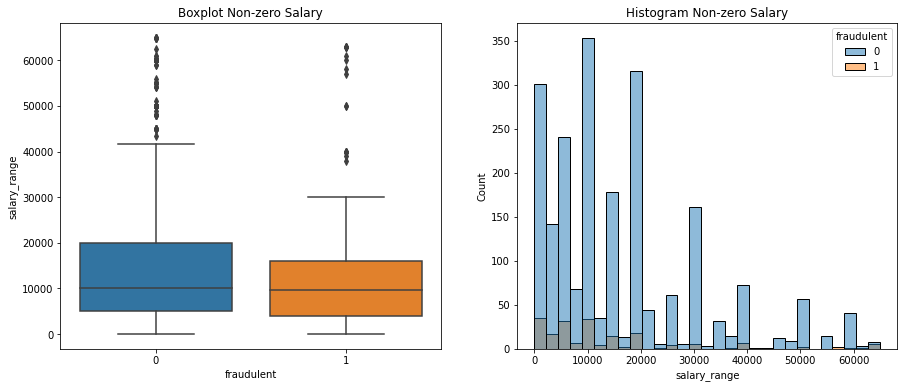

In [10]:
# create boxplot and histogram for the nonzero salaries
box_title = 'Boxplot Non-zero Salary'
hist_title = 'Histogram Non-zero Salary'
fig, axes = plt.subplots(1, 2, figsize=(15, 6))

sns.boxplot(x='fraudulent', y='salary_range', data=non_zero_salary, ax=axes[0]).set_title(box_title)
sns.histplot(hue='fraudulent', x='salary_range', data=non_zero_salary, ax=axes[1]).set_title(hist_title)
plt.show()

Based on the historgram, there really is not a ton of nonzero salary data (but we knew that already). The histogram also reveals similar distributions for the real and fake jobs postings. The boxplot is slightly more revealing. The real jobs have a greater spread than the fake ones, but the means are about the same (although, its hard to believe that the mean salary is around $10,000).

## Categorical Features

Time to take another look at some of the other features.

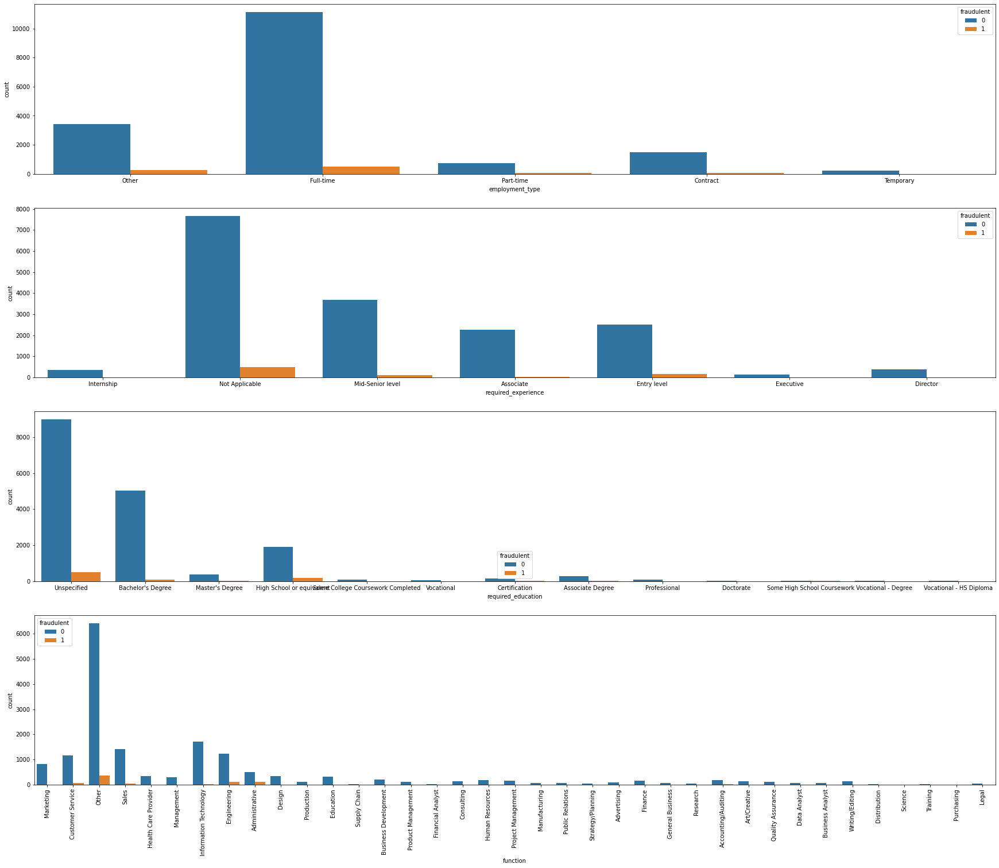

In [11]:
fig, axes = plt.subplots(4, 1, figsize=(30, 25))
plt.xticks(rotation=90)
sns.countplot(x="employment_type", hue="fraudulent", data=data, ax=axes[0])
sns.countplot(x="required_experience", hue="fraudulent", data=data, ax=axes[1])
sns.countplot(x="required_education", hue="fraudulent", data=data, ax=axes[2])
sns.countplot(x="function", hue="fraudulent", data=data, ax=axes[3])
plt.show()

The distributions of real and fake jobs are roughly the same for these features. Mostly full time, unspecified or bachelors education, or an *Other* job fuction. 

Time to take a look at some the binary features.

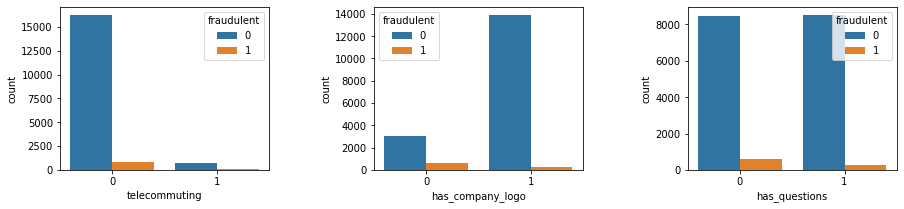

In [12]:
fig, axes = plt.subplots(1, 3, figsize=(15, 3))
sns.countplot(x="telecommuting", hue="fraudulent", data=data, ax=axes[0])
sns.countplot(x="has_company_logo", hue="fraudulent", data=data, ax=axes[1])
sns.countplot(x="has_questions", hue="fraudulent", data=data, ax=axes[2])
plt.subplots_adjust(wspace=0.5)
plt.show()

All of these features are pretty imbalanced, but that was kind of expected.

## Word Clouds

Now, I'll dive into the text data. A word cloud is a nice representation of the the most prominent words that appear in textual data. I'll create two seperate word clouds, one for the real job postings and one for the fake ones.

In [18]:
all_words_good = " ".join([review for review in data[data['fraudulent']==0]['text']])
word_cloud_good = WordCloud(width=200, height=100, background_color="white", random_state=1, max_font_size=60).generate(all_words_good)
plt.figure(figsize=(200, 100))
plt.imshow(word_cloud_good, interpolation='bilinear')
plt.axis('off')
plt.title("Real Job Postings Word Cloud", fontsize=20)
plt.show()

In [19]:
all_words_bad = " ".join([review for review in data[data['fraudulent']==1]['text']])
word_cloud_bad = WordCloud(width=200, height=100, background_color="white", random_state=1, max_font_size=60).generate(all_words_bad)
plt.figure(figsize=(200, 100))
plt.imshow(word_cloud_bad, interpolation='bilinear')
plt.axis('off')
plt.title("Fake Job Postings Word Cloud", fontsize=20)
plt.show()

There are a lot of different words in both word clouds, but none of the words really jump out at me for being obviously real or obviously fake.